# Accessibility to amenities: data preparation
Amenity type: 'Social & Leisure', 'Essential needs', 'Health services', 'Education'
('Civic and utility', 'Restaurant', 'Other')

Time threshold: 15 min, 30 min, 45 min.

Mode: Walking, Public transit + Walking, Car

In [2]:
%load_ext autoreload
%autoreload 2
%cd D:\netmob25

D:\netmob25


In [3]:
# Load libs
import os
os.environ['USE_PYGEOS'] = '0'
import pandas as pd
import geopandas as gpd
import folium
from folium import GeoJson
from tqdm.notebook import tqdm
import time
from lib import helpers as helpers

## 1. OSM data

In [13]:
gdf_h3 = gpd.read_file('dbs/geo/h3_10.gpkg', layer='h3_10')
# Convert to WGS84 if not already
gdf_h3 = gdf_h3.to_crs(epsg=4326)

# Create a base map
m = folium.Map(location=[gdf_h3.geometry.centroid.y.mean(), gdf_h3.geometry.centroid.x.mean()], zoom_start=10)

# Add GeoJSON overlay
folium.GeoJson(gdf_h3).add_to(m)

# Display in notebook
m

C:\Users\yuanlia\AppData\Local\Temp\ipykernel_13508\1286520286.py:6: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  m = folium.Map(location=[gdf_h3.geometry.centroid.y.mean(), gdf_h3.geometry.centroid.x.mean()], zoom_start=10)


<Axes: >

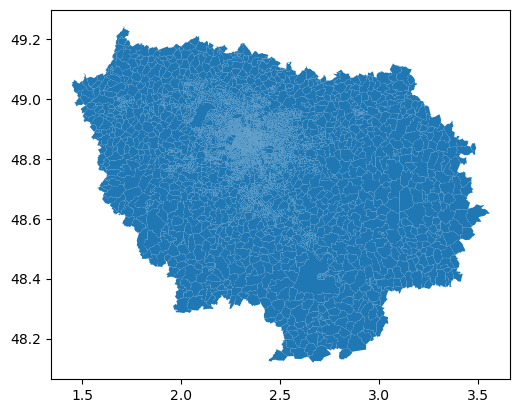

In [9]:
gdf = gpd.read_file('dbs/geo/paris_iris.geojson')
gdf.plot()

In [10]:
# Load h3 hexagons
gdf = gdf.to_crs(epsg=32631)
convex_hull = gdf.unary_union.convex_hull.buffer(2000)
convex_hull = gpd.GeoDataFrame(geometry=[convex_hull], crs=gdf.crs)
print("Area", convex_hull.area / 10**6)

C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\1854796152.py:3: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  convex_hull = gdf.unary_union.convex_hull.buffer(2000)


Area 0    14880.668833
dtype: float64


In [24]:
helpers.gdf2poly(geodata=convex_hull, targetfile=f'dbs/geo/gp_bounding.poly', buffer=0)

### 1.1 Crop the data to the area

In [26]:
# Process data
ROOT_dir = "D:/netmob25/"
osm_file = ROOT_dir + 'dbs/geo/france-latest.osm.pbf'
terget_file = ROOT_dir + 'dbs/accessibility/data/france-gp.osm.pbf'
poly_file = ROOT_dir + f'dbs/geo/gp_bounding.poly'
osmosis_path = 'osmosis'
helpers.osm_country2region(osm_file=osm_file, 
                           terget_file=terget_file,  
                           poly_file=poly_file,
                           osmosis_path=osmosis_path)

osmosis --read-pbf file="D:/netmob25/dbs/geo/france-latest.osm.pbf" --bounding-polygon file="D:/netmob25/dbs/geo/gp_bounding.poly" --write-pbf file="D:/netmob25/dbs/accessibility/data/france-gp.osm.pbf"


## 2. Prepare activity locations as origins

In [7]:
full_trajectory_summary= pd.read_parquet(f'dbs/data_p/stays_extraction_all.parquet')
# Extract start coordinates and hour
start_coords = full_trajectory_summary[['start_lon', 'start_lat', 'start_time']].copy()
start_coords = start_coords.rename(columns={'start_lon': 'lon', 'start_lat': 'lat'})
start_coords['hour'] = pd.to_datetime(start_coords['start_time']).dt.hour
start_coords = start_coords[['lon', 'lat', 'hour']]

# Extract end coordinates and hour
end_coords = full_trajectory_summary[['end_lon', 'end_lat', 'end_time']].copy()
end_coords = end_coords.rename(columns={'end_lon': 'lon', 'end_lat': 'lat'})
end_coords['hour'] = pd.to_datetime(end_coords['end_time']).dt.hour
end_coords = end_coords[['lon', 'lat', 'hour']]

# Concatenate and drop duplicates based on lon, lat, and hour
unique_coords = pd.concat([start_coords, end_coords], ignore_index=True).drop_duplicates(subset=['lon', 'lat', 'hour'])
print(f"Unique coordinates count: {len(unique_coords)}")

Unique coordinates count: 105428


In [12]:
# Reset index for clarity
for hr, group in unique_coords.groupby('hour'):
    print(f"Hour {hr}: {len(group)} unique coordinates")
    group_c = group.reset_index(drop=True)
    group_c.loc[:, 'id'] = range(1, len(group_c) + 1)
    group_c = group_c[['id', 'lon', 'lat']]
    print("No. of origins", len(group_c))

    # Keep only origins within the convex hull
    group_c = gpd.GeoDataFrame(group_c, geometry=gpd.points_from_xy(group_c.lon, group_c.lat), crs='EPSG:4326')
    group_c = group_c.to_crs(epsg=32631)
    group_c = group_c[group_c.geometry.within(gdf.unary_union)]
    print("No. of origins within Paris", len(group_c))
    group_c[['id', 'lon', 'lat']].to_csv(f'dbs/accessibility/data/origins_{hr}.csv', index=False)
    

Hour 0: 613 unique coordinates
No. of origins 613


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 610
Hour 1: 315 unique coordinates
No. of origins 315


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 312
Hour 2: 136 unique coordinates
No. of origins 136


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 136
Hour 3: 90 unique coordinates
No. of origins 90


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 90
Hour 4: 140 unique coordinates
No. of origins 140


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 140
Hour 5: 309 unique coordinates
No. of origins 309


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 306
Hour 6: 1178 unique coordinates
No. of origins 1178


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 1173
Hour 7: 3939 unique coordinates
No. of origins 3939


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 3929
Hour 8: 7880 unique coordinates
No. of origins 7880


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 7842
Hour 9: 6265 unique coordinates
No. of origins 6265


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 6208
Hour 10: 5523 unique coordinates
No. of origins 5523


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 5480
Hour 11: 6633 unique coordinates
No. of origins 6633


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 6594
Hour 12: 8222 unique coordinates
No. of origins 8222


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 8163
Hour 13: 7316 unique coordinates
No. of origins 7316


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 7279
Hour 14: 5883 unique coordinates
No. of origins 5883


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 5833
Hour 15: 6035 unique coordinates
No. of origins 6035


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 5988
Hour 16: 8042 unique coordinates
No. of origins 8042


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 7972
Hour 17: 9562 unique coordinates
No. of origins 9562


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 9487
Hour 18: 9966 unique coordinates
No. of origins 9966


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 9906
Hour 19: 7419 unique coordinates
No. of origins 7419


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 7363
Hour 20: 4316 unique coordinates
No. of origins 4316


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 4281
Hour 21: 2433 unique coordinates
No. of origins 2433


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 2415
Hour 22: 1924 unique coordinates
No. of origins 1924


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 1911
Hour 23: 1289 unique coordinates
No. of origins 1289


C:\Users\yuanlia\AppData\Local\Temp\ipykernel_19172\4000161591.py:12: DeprecationWarning: The 'unary_union' attribute is deprecated, use the 'union_all()' method instead.
  group_c = group_c[group_c.geometry.within(gdf.unary_union)]


No. of origins within Paris 1282


## 3. Prepare POIs as destinations

In [11]:
gdf_poi = gpd.read_file('dbs/geo/pois.gpkg', layer='pois')
gdf_poi = gdf_poi.to_crs(epsg=4326)
gdf_poi.loc[:, 'lon'] = gdf_poi.geometry.x
gdf_poi.loc[:, 'lat'] = gdf_poi.geometry.y
for tag, nm in zip(['Social & Leisure', 'Essential needs', 'Health services', 'Education'], ['sl', 'en', 'hs', 'ed']):
    df2save = gdf_poi.loc[gdf_poi['tag'] == tag, ['id', 'lon', 'lat']].copy()
    df2save = df2save.reset_index(drop=True)
    df2save.loc[:, 'job'] = 1
    df2save.to_csv(f"dbs/accessibility/data/destinations_{nm}.csv", index=False)